## Maxwell Boltzmann Distribution

This file contains code to simulate the collisions of oxygen molecules in a 2d gas in order to recover the Maxwell-Boltmzmann and Boltzmann distributions.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import matplotlib
from scipy.optimize import curve_fit
from IPython.display import HTML, display, clear_output
from itertools import combinations

In [2]:
# Increases filesize limit for animation
matplotlib.rcParams['animation.embed_limit'] = 100000000

npoint = 400  # Number of molecules.
nframe = 500  # Number of frames of animation (2 timesteps per frame).
xmin, xmax, ymin, ymax = 0, 1, 0, 1  # Boundary of the gas.
Dt = 0.00002  # Timestep size.

# Creates a key to read particle pairs. This is used in order to
# read and update the velocities of the molecules undergoing collisions.
# No molecules are destroyed and the indexing does not change, so this
# to only be generated once.
indexcombos = np.asarray(list(combinations(np.arange(0, npoint), 2)))


def update_point(num):
    """Update a matplotlib plot simulating molecular collisions in a 2d gas.
    For use with matplotlib.animation.FuncAnimation().

    Keyword arguments:
    -num :  required for use with matplotlib.animation.FuncAnimation()
            not used inside update().

    Required variables:
    -x, y :  separate arrays respectively containing x and y coordinates
             of molecules. Global variables declared outside function.
    -vx, vy :  separate arrays respectively containing x and y velocities
               of molecules. Global variables declared outside function.
               In m/s.
    """

    global x, y, vx, vy  # Making global variables available for use.

    print('.', end='')  # Progress bar.

    for i in range(2):

        # Computes the change in x and y.
        dx = Dt * vx
        dy = Dt * vy

        # Computes new x and y coordinates.
        x = x + dx
        y = y + dy

        # Accounts for colusions of molecules with borders. If a particle
        # is past the border its velocity is multiplied by -1, making it
        # 'bounce' off the border.
        indx = np.where((x < xmin) | (x > xmax))
        indy = np.where((y < ymin) | (y > ymax))
        vx[indx] = -vx[indx]
        vy[indy] = -vy[indy]

        # Creates all possible combinations between x and y variables.
        xx = np.asarray(list(combinations(x, 2)))
        yy = np.asarray(list(combinations(y, 2)))

        # Computes all possible distances between particle combinations.
        dd = (xx[:, 0]-xx[:, 1])**2 + (yy[:, 0]-yy[:, 1])**2

        # Note: Collisions are calculated to be between 2 particles at
        # a time.

        # Creating masks for the particles involved in collisions, by
        # filtering where the distance between two particles squared
        # is <= 4 * (radius of molecule)^2. This uses the indexcombinations
        # created previously in order to determine the indices of vx and vy
        # of particles 1 and 2.
        par1 = indexcombos[dd <= (2 * 0.0015)**2][:, 0]
        par2 = indexcombos[dd <= (2 * 0.0015)**2][:, 1]

        # Creating position and velocity vectors for molecules 1 and 2
        # involved in collisions.
        v1 = np.array([vx[par1], vy[par1]])
        v2 = np.array([vx[par2], vy[par2]])
        x1 = np.array([x[par1], y[par1]])
        x2 = np.array([x[par2], y[par2]])

        # Computes the change in the velocity vectors of molecules 1 and 2
        # involved in collisions.
        dV1 = (np.sum((v1 - v2) * (x1 - x2), axis=0) /
               np.sum((x1 - x2)**2, axis=0))
        dV2 = (np.sum((v2 - v1) * (x2 - x1), axis=0) /
               np.sum((x2 - x1)**2, axis=0))

        # Updates velocity vectors of molecules involved in collisions.
        v1 = v1 - dV1 * (x1 - x2)
        v2 = v2 - dV2 * (x2 - x1)

        # Updates velocities in vx and vy according to updated velocity vectors
        # of molecules 1 and 2.
        vx[par1], vy[par1] = v1
        vx[par2], vy[par2] = v2

    # Prepare x and y coordinates to be used in im.set_offsets().
    data = np.stack((x, y), axis=-1)

    # Updates the image.
    im.set_offsets(data)

    return


# Creates matplotlib figure and sets boundaries.
fig, ax = plt.subplots(figsize=(6, 6))
plt.xlim(xmin, xmax)
plt.ylim(ymin, ymax)

# Creates npoint number of random points.
x = np.random.random(npoint)
y = np.random.random(npoint)

# Sets initial velocities of particles.
vx = -500.*np.ones(npoint)
vy = np.zeros(npoint)
vx[np.where(x <= 0.5)] = -vx[np.where(x <= 0.5)]

# Creates array containing colour information for each point.
colour = np.empty(npoint, dtype=str)
colour[:] = 'r'
colour[np.where(x <= 0.5)] = 'b'

# Creates first plot to be updated.
im = ax.scatter(x, y, c=colour)

# Sets sizes of points.
im.set_sizes([10])

# Creates animation by updating elements of im.
anim = animation.FuncAnimation(fig, update_point, nframe,
                               interval=30, repeat=False)
plt.close()

# Displays animation.
HTML(anim.to_jshtml())

.....................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

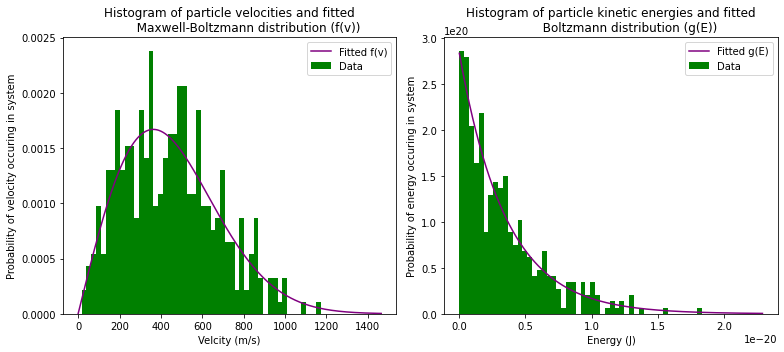

By fitting the Maxwell-Bolzmann distribution to the velocity data, we determined the system temperature to be 255.68 Kelvin


In [3]:
kB = 1.38e-23  # Boltzmann constant in kg s^-2 K^-1.
m = 2.672e-26  # mass of O2 molecule in kg.

Tguess = 250  # Initial guess for temperature of the system in Kelvin.

v = np.sqrt(vx**2+vy**2)  # Magnitude of velocity per particle.
E = 0.5 * m * v**2  # Energy per particle.

vmodel = np.linspace(0, 1.25 * np.amax(v), 1000)
Emodel = np.linspace(0, 1.25 * np.amax(E), 1000)


def MBdist(v, T):
    """Fit function for Maxwell-Boltzmann distribution of velocity.

    Keyword Arguments:
    v :  Array of velocities of particles in system in m/s.
    T :  Temperature of system in Kelvin.

    Required variables:
    m :  Mass of particles in system in kg.
    kB :  Boltzmann constant in kg s^-2 K^-1
    """
    global m, kB
    return (m * v) / (kB * T) * np.exp(-m * v**2 / (2 * kB * T))


def Bdist(E, T):
    """Fit function for Boltzmann distribution of energy.

    Keyword Arguments:
    v :  Array of velocities of particles in system in m/s.
    T :  Temperature of system in Kelvin.

    Required variables:
    m :  Mass of particles in system in kg.
    kB :  Boltzmann constant in kg s^-2 K^-1
    """
    global m, kB
    return 1 / (kB * T) * np.exp(-E / (kB * T))


# Create figure
plt.figure(figsize=(11, 5))


plt.subplot(121)
plt.title('Histogram of particle velocities and fitted\n\
          Maxwell-Boltzmann distribution (f(v))')

# Plot histogram, saving important parameters to variables.
# vN contains count for velocities in each bin.
# vBins contains borders of bins.
vN, vBins, vPatch = plt.hist(v, density=True, bins=50,
                             color='green', label='Data')

# Calculates the midpoint of each bin for fitting process.
vmid = (vBins[:-1] + vBins[1:]) / 2

# Fitting Maxwell-Boltzmann distribution to histogram.
T, MB_cov = curve_fit(MBdist, vmid, vN, p0=Tguess)
plt.plot(vmodel, MBdist(vmodel, T), 'purple', label='Fitted f(v)')
plt.xlabel('Velcity (m/s)')
plt.ylabel('Probability of velocity occuring in system')
plt.legend()


plt.subplot(122)
plt.title('Histogram of particle kinetic energies and fitted\n\
          Boltzmann distribution (g(E))')

# Plot histogram, saving important parameters to variables.
# vN contains count for velocities in each bin.
# vBins contains borders of bins.
EN, EBins, EPatch = plt.hist(E, density=True, bins=50,
                             color='green', label='Data')
# Plotting Boltzmann distribution
plt.plot(Emodel, Bdist(Emodel, T), 'purple', label='Fitted g(E)')
plt.xlabel('Energy (J)')
plt.ylabel('Probability of energy occuring in system')
plt.legend()


plt.tight_layout()
plt.show()


print("By fitting the Maxwell-Bolzmann distribution to the velocity "
      "data, we determined the system temperature to be",
      f"{float(T.round(decimals=2))} Kelvin")